# Library

In [107]:
import tensorflow as tf
from tensorflow import keras

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import json

from sklearn.model_selection import train_test_split


import os
import copy
import math

from skimage.io import imread
from skimage.transform import resize
from glob import glob

from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras import utils

from PIL import Image, ImageDraw

from albumentations import HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

# GPU

In [3]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [4]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  try:
    # 메모리 사용 제한을 위한 설정
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
    # 특정 GPU만 사용하도록 설정
    tf.config.experimental.set_visible_devices(gpus[0], 'GPU')
  except RuntimeError as e:
    # 프로그램 시작 후에는 GPU 설정을 변경할 수 없으므로
    # 런타임 오류 발생 시 예외 처리가 필요함
    print(e)

Num GPUs Available:  1


# dataset

In [5]:
DATA_PATH =  os.getenv('HOME') + '/aiffel/GoingDeeper/GD5/data'

In [12]:
TRAIN_PATH = DATA_PATH + '/training'
TEST_PATH = DATA_PATH + '/testing'

# augmentation

In [9]:
def build_augmentation(is_train=True):
  if is_train:    # 훈련용 데이터일 경우
    return Compose([
                    HorizontalFlip(p=0.5),    # 50%의 확률로 좌우대칭
                    RandomSizedCrop(         # 50%의 확률로 RandomSizedCrop
                        min_max_height=(300, 370),
                        w2h_ratio=370/1242,
                        height=224,
                        width=224,
                        p=0.5
                        ),
                    Resize(              # 입력이미지를 224X224로 resize
                        width=224,
                        height=224
                        )
                    ])
  return Compose([      # 테스트용 데이터일 경우에는 224X224로 resize만 수행합니다. 
                Resize(
                    width=224,
                    height=224
                    )
                ])

In [10]:
augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)

In [13]:
input_images = glob(os.path.join(TRAIN_PATH, "image_2", "*.png"))

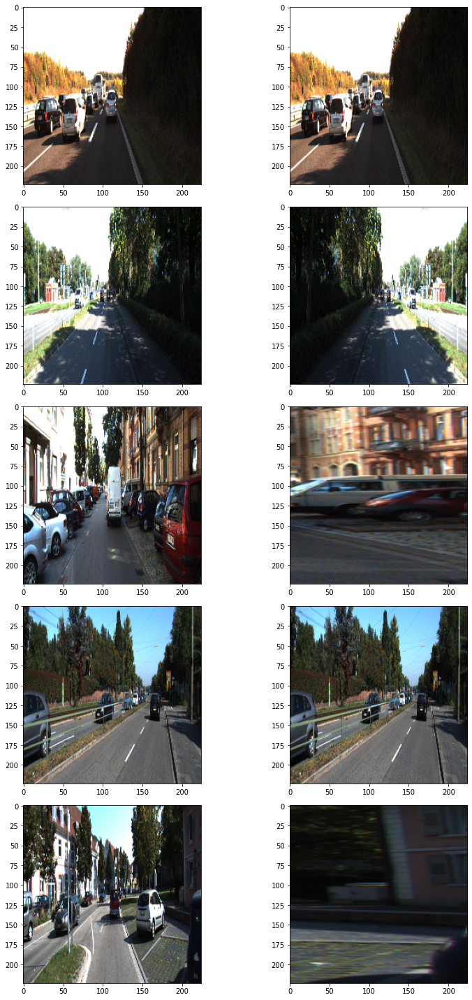

In [24]:
# 훈련 데이터셋에서 5개만 가져와 augmentation을 적용해 봅시다.  
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data) # w,h 만 변경
    processed = augmentation_train(**image_data) # aug진행
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  # 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  # 오른쪽이 augment된 이미지

plt.tight_layout()
plt.show()


In [19]:
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=8,  # 메모리 문제로 인하여 배치크기 감소
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]

    if self.is_train:
      return data[:-30]
    return data[-30:]
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size)

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
      return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes

In [20]:
train_preproc = build_augmentation(is_train=True)
test_preproc = build_augmentation(is_train=False)

In [22]:
train_generator = KittiGenerator(
    TRAIN_PATH,
    augmentation=train_preproc,
    is_train=True
)

test_generator = KittiGenerator(
    TRAIN_PATH,
    augmentation=test_preproc,
    is_train=False
)

# UNET 모델 구현

https://pasus.tistory.com/204

In [25]:
EPOCHS = 100

In [53]:
def conv_block(filters, x):
    x = Conv2D(filters, 3, activation='relu', padding='same',kernel_initializer='he_normal')(x)
    x = BatchNormalization()(x)  # x = Dropout(0.5)(x)
    x = Conv2D(filters, 3, activation='relu', padding='same',kernel_initializer='he_normal')(x)
    x = BatchNormalization()(x)  # x = Dropout(0.5)(x)
    return x

In [76]:
def encoder(filters, x) :
    x = conv_block(filters, x)
    pool = MaxPooling2D(pool_size =(2,2))(x)
    return x, pool

In [62]:
def decoder(filters, x, concat):
    x = Conv2DTranspose(filters, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(x)
    x = concatenate([concat, x], axis=3)
    x = conv_block(filters, x)
    return x

In [56]:
def get_outputs(x):
    x = Conv2D(2, 3, activation='relu', padding='same',kernel_initializer='he_normal')(x)     
    x = Conv2D(1, 1, activation='sigmoid')(x)
    return x

In [77]:
def build_unet(input_shape=(224,224,3)):
    inputs = Input(input_shape)
    
    filters = [64, 128, 256, 512, 1024]
    
    #contracting path
    e1, p1 = encoder(filters[0], inputs)
    e2, p2 = encoder(filters[1], p1)
    e3, p3 = encoder(filters[2], p2)
    e4, p4 = encoder(filters[3], p3)
    
    # bridge
    b1 = conv_block(filters[4], p4)
    
    #expanding path
    d4 = decoder(filters[3], b1, e4)
    d3 = decoder(filters[2], d4, e3)
    d2 = decoder(filters[1], d3, e2)
    d1 = decoder(filters[0], d2, e1)
    
    # output
    outputs = get_outputs(d1)
    
    #model
    model = Model(inputs = inputs, outputs = outputs)
    return model

In [78]:
unet = build_unet()

In [79]:
unet.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_112 (Conv2D)             (None, 224, 224, 64) 1792        input_11[0][0]                   
__________________________________________________________________________________________________
batch_normalization_108 (BatchN (None, 224, 224, 64) 256         conv2d_112[0][0]                 
__________________________________________________________________________________________________
conv2d_113 (Conv2D)             (None, 224, 224, 64) 36928       batch_normalization_108[0][0]    
____________________________________________________________________________________________

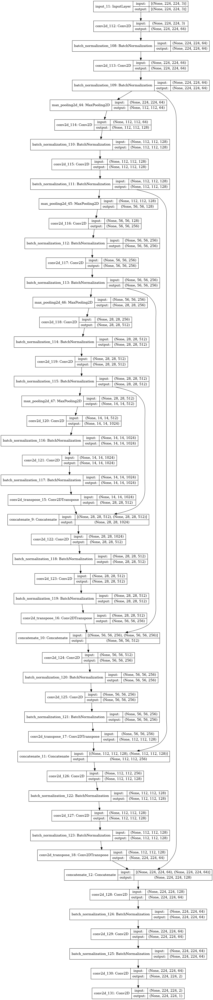

In [80]:
utils.plot_model(unet, show_shapes =True)

In [89]:
MODEL_PATH = DATA_PATH +'/UNET'

In [90]:
unet.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=['accuracy'])

In [91]:
callbacks = keras.callbacks.ModelCheckpoint(
    filepath = MODEL_PATH,
    save_best_only = True,
    save_weights_only = False,
    monitor = 'val_accuracy',
    mode = 'max',
    verbose = 1
)

In [92]:
unet_history = unet.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=EPOCHS,
    callbacks = [callbacks]
)

Epoch 1/100
22/22 [==============================] - 11s 429ms/step - loss: 0.6770 - accuracy: 0.9142 - val_loss: 0.6814 - val_accuracy: 0.9622

Epoch 00001: val_accuracy improved from -inf to 0.96219, saving model to /aiffel/aiffel/GoingDeeper/GD5/data/UNET
INFO:tensorflow:Assets written to: /aiffel/aiffel/GoingDeeper/GD5/data/UNET/assets
Epoch 2/100
22/22 [==============================] - 9s 390ms/step - loss: 0.6631 - accuracy: 0.9672 - val_loss: 0.6750 - val_accuracy: 0.9667

Epoch 00002: val_accuracy improved from 0.96219 to 0.96670, saving model to /aiffel/aiffel/GoingDeeper/GD5/data/UNET
INFO:tensorflow:Assets written to: /aiffel/aiffel/GoingDeeper/GD5/data/UNET/assets
Epoch 3/100
22/22 [==============================] - 9s 392ms/step - loss: 0.6427 - accuracy: 0.9762 - val_loss: 0.6808 - val_accuracy: 0.9769

Epoch 00003: val_accuracy improved from 0.96670 to 0.97695, saving model to /aiffel/aiffel/GoingDeeper/GD5/data/UNET
INFO:tensorflow:Assets written to: /aiffel/aiffel/Goi


Epoch 00035: val_accuracy did not improve from 0.99125
Epoch 36/100
22/22 [==============================] - 9s 407ms/step - loss: 0.1229 - accuracy: 0.9900 - val_loss: 0.3760 - val_accuracy: 0.9873

Epoch 00036: val_accuracy did not improve from 0.99125
Epoch 37/100
22/22 [==============================] - 9s 407ms/step - loss: 0.1202 - accuracy: 0.9862 - val_loss: 0.6568 - val_accuracy: 0.9708

Epoch 00037: val_accuracy did not improve from 0.99125
Epoch 38/100
22/22 [==============================] - 9s 408ms/step - loss: 0.1165 - accuracy: 0.9889 - val_loss: 0.6175 - val_accuracy: 0.9850

Epoch 00038: val_accuracy did not improve from 0.99125
Epoch 39/100
22/22 [==============================] - 9s 406ms/step - loss: 0.1147 - accuracy: 0.9910 - val_loss: 0.1361 - val_accuracy: 0.9910

Epoch 00039: val_accuracy did not improve from 0.99125
Epoch 40/100
22/22 [==============================] - 9s 406ms/step - loss: 0.1125 - accuracy: 0.9895 - val_loss: 0.1131 - val_accuracy: 0.9849


22/22 [==============================] - 9s 406ms/step - loss: 0.0844 - accuracy: 0.9841 - val_loss: 0.2854 - val_accuracy: 0.9753

Epoch 00075: val_accuracy did not improve from 0.99295
Epoch 76/100
22/22 [==============================] - 9s 408ms/step - loss: 0.0788 - accuracy: 0.9912 - val_loss: 0.0812 - val_accuracy: 0.9836

Epoch 00076: val_accuracy did not improve from 0.99295
Epoch 77/100
22/22 [==============================] - 9s 408ms/step - loss: 0.0777 - accuracy: 0.9928 - val_loss: 0.0821 - val_accuracy: 0.9810

Epoch 00077: val_accuracy did not improve from 0.99295
Epoch 78/100
22/22 [==============================] - 9s 408ms/step - loss: 0.0741 - accuracy: 0.9913 - val_loss: 0.0852 - val_accuracy: 0.9911

Epoch 00078: val_accuracy did not improve from 0.99295
Epoch 79/100
22/22 [==============================] - 9s 407ms/step - loss: 0.0723 - accuracy: 0.9952 - val_loss: 0.0730 - val_accuracy: 0.9905

Epoch 00079: val_accuracy did not improve from 0.99295
Epoch 80/100


# visualization

In [187]:
def draw_history(history, model_name='UNet'):
    plt.subplots(figsize=(10,10))

    # Model Loss, Validation Loss 시각화
    plt.subplot(121)
    plt.plot(history.history['loss'], 'r')
    plt.plot(history.history['val_loss'], 'b')
    plt.title(f'{model_name} Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['loss', 'val_loss'], loc='upper left')

    # Model Accuracy, Validation Accuracy 시각화
    plt.subplot(122)
    plt.plot(history.history['accuracy'], 'r')
    plt.plot(history.history['val_accuracy'], 'b')
    plt.title(f'{model_name} Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['accuracy', 'val_accuracy'], loc='upper left')
    
    plt.tight_layout()
    plt.show()

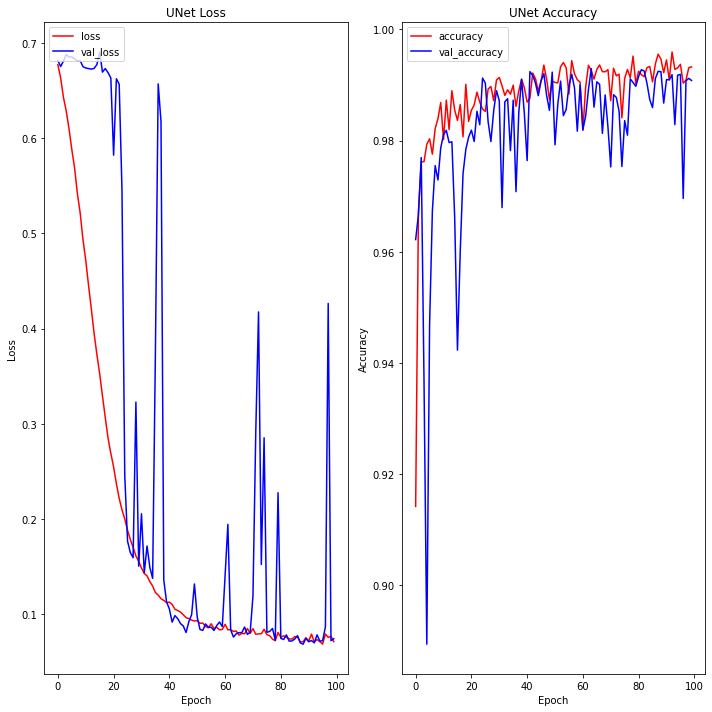

In [100]:
draw_history(unet_history, 'UNet')

In [108]:
# 학습 히스토리 저장
json.dump(unet_history, open("unet_history.json", 'w'))

In [109]:
# 저장된 모델 가중치 및 히스토리 불러오기
history_unet = json.load(open("unet_history.json", 'r'))

In [112]:
UNET_PATH = DATA_PATH +'/UNET.h5'

In [113]:
unet.save(UNET_PATH)

# UNET++ 모델 구현

* U-Net++은 U-Net과 크게 2가지의 차이점
    * Re-designed skip pathways : U-Net에서도 Skip-Connection을 해주는 부분이 있었지만, U-Net++에서는 DenseNet의 아이디어를 차용하여 Encoder(수축 경로)와 Decoder(확장 경로)사이의 Semantic(의미적) Gap을 연결시켜 줍니다.
    * Deep Supervision : 각 브랜치의 출력(빨간색 선으로 표시된 부분)을 평균해서 최종 결과로서 사용하는 방법입니다.
    
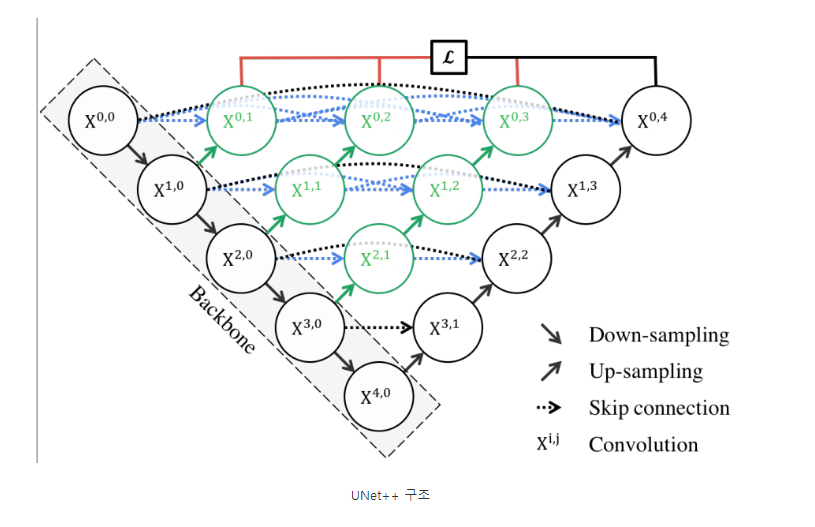

* 위는 UNet++의 구조를 나타냅니다. 검은색 동그라미와 선은 기존 UNet의 구조를 의미하는 것이고, 파란색 선과 초록색 선은 UNet++의 추가적인 아이디어를 의미합니다. 이것을 조금 더 자세하게 알아보겠습니다.

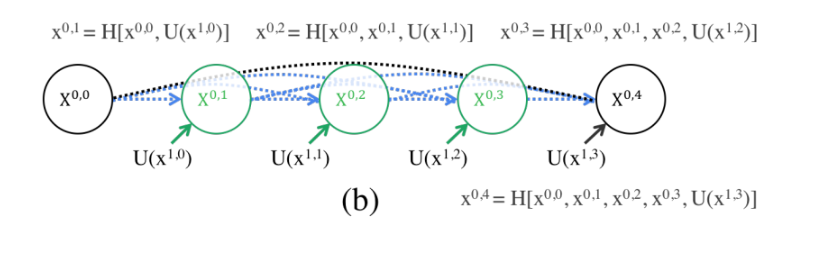

위 그림은 Feature map(이미지)이 첫 번째 Skip Pathway를 통과하는 것을 보여줍니다.

기존 U-Net에서는 X0_0에서 X0_4로 가는 하나의 Skip만이 존재하였습니다. 그러나, U-Net++에서는 X0_0이 크기가 키워진(Upsampling) X1_0과 Concatenate되어 X0_1로 가는 것을 볼 수 있습니다. 그리고 이렇게 만들어진 X0_1은 또 다시 Upsampling된 X1_1과 Concatenate되어 X1_2로 흘려줍니다. 이런식으로 하면 저자들은 Encoder와 Decoder의 Feature map간의 Semantic Gap을 더 줄일 수 있게 된다고 언급합니다.

그리고, Deep Supervision은 여러 Semantic Level(위 구조에서는 4개)은 각각 Feature map을 생성하여 정보를 가지고 있습니다. 따라서, 4개의 시맨틱 정보를 모두 이용하여 평균내어 결과를 예측하였습니다. Deep Supervision 방법은 선택적으로 적용할 수 있습니다.

https://wsshin.tistory.com/2

In [166]:
def build_unet_pp (input_shape = (224,224,3), deep_supervision=True) :
    inputs = Input(input_shape)
    
    filters = [64,128,256,512,1024]
    
    #backbone
    e00, p00 = encoder(filters[0], inputs)
    e10, p10 = encoder(filters[1], p00)
    e20, p20 = encoder(filters[2], p10)
    e30, p30 = encoder(filters[3], p20)
    x40 = conv_block(filters[4], p30)
    
    # --------------------------------------------------
    x01 = decoder(filters[0], e10, e00)
    
    # --------------------------------------------------
    x11 = decoder(filters[1], e20, e10)
    
    concat02 = concatenate([e00, x01], axis = -1)
    x02 = decoder(filters[0], x11, concat02)
    
    # --------------------------------------------------
    x21 = decoder(filters[2], e30, e20)
    
    concat12 = concatenate([e10, x11], axis = -1)
    x12 = decoder(filters[1], x21, concat12)
    
    concat03 = concatenate([e00, x01, x02], axis = -1)
    x03 = decoder(filters[0], x12, concat03)
    
    # --------------------------------------------------
    x31 = decoder(filters[3], x40, e30)
    
    concat22 = concatenate([e20, x21], axis = -1)
    x22 = decoder(filters[2], x31, concat22)
    
    concat13 = concatenate([e10, x11, x12], axis = -1)
    x13 = decoder(filters[1], x22, concat13)
    
    concat04 = concatenate([e00, x01, x02, x03], axis = -1)
    x04 = decoder(filters[0], x13, concat04)
    
    # --------------------------------------------------
    x01_outputs = get_outputs(x01)
    x02_outputs = get_outputs(x02)
    x03_outputs = get_outputs(x03)
    x04_outputs = get_outputs(x04)
        
    if deep_supervision :    
        output_list = [x01_outputs, x02_outputs, x03_outputs, x04_outputs]
        outputs = tf.keras.layers.Average()(output_list)  # 레이어 모든 값 평균 계산 => sum(outputs_list)/len(outputs_list) 과 결과 같음
    
    else:
        outputs = x04_outputs
    
    model = Model(inputs = inputs, outputs = outputs)
    
    return model
    

In [169]:
unet_pp = build_unet_pp()

In [170]:
unet_pp.summary()

Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_52 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_690 (Conv2D)             (None, 224, 224, 64) 1792        input_52[0][0]                   
__________________________________________________________________________________________________
batch_normalization_664 (BatchN (None, 224, 224, 64) 256         conv2d_690[0][0]                 
__________________________________________________________________________________________________
conv2d_691 (Conv2D)             (None, 224, 224, 64) 36928       batch_normalization_664[0][0]    
____________________________________________________________________________________________

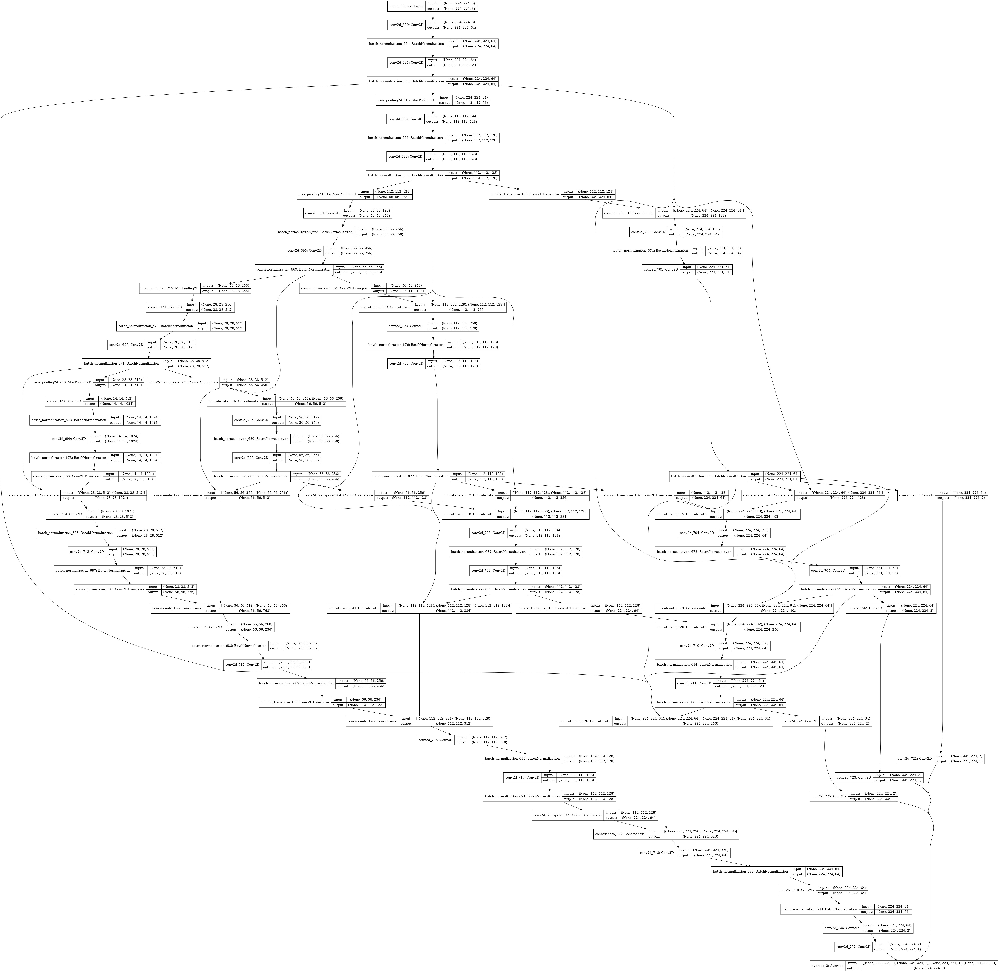

In [172]:
tf.keras.utils.plot_model(unet_pp, show_shapes =True)

In [173]:
UNET_PP_PATH = DATA_PATH +'/UNET_PP.h5'

In [174]:
unet_pp.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=['accuracy'])

In [176]:
callbacks = keras.callbacks.ModelCheckpoint(
    filepath = UNET_PP_PATH,
    save_best_only = True,
    save_weights_only = False,
    monitor = 'val_accuracy',
    mode = 'max',
    verbose = 1
)

In [177]:
unet_pp_history = unet_pp.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=EPOCHS,
    callbacks = [callbacks]
)

Epoch 1/100
22/22 [==============================] - 35s 1s/step - loss: 0.5190 - accuracy: 0.8087 - val_loss: 0.6573 - val_accuracy: 0.9278

Epoch 00001: val_accuracy improved from -inf to 0.92780, saving model to /aiffel/aiffel/GoingDeeper/GD5/data/UNET_PP.h5


/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Epoch 2/100
22/22 [==============================] - 22s 999ms/step - loss: 0.4288 - accuracy: 0.9092 - val_loss: 0.5788 - val_accuracy: 0.9373

Epoch 00002: val_accuracy improved from 0.92780 to 0.93729, saving model to /aiffel/aiffel/GoingDeeper/GD5/data/UNET_PP.h5
Epoch 3/100
22/22 [==============================] - 22s 1s/step - loss: 0.4040 - accuracy: 0.9336 - val_loss: 0.5033 - val_accuracy: 0.9396

Epoch 00003: val_accuracy improved from 0.93729 to 0.93961, saving model to /aiffel/aiffel/GoingDeeper/GD5/data/UNET_PP.h5
Epoch 4/100
22/22 [==============================] - 23s 1s/step - loss: 0.3997 - accuracy: 0.9595 - val_loss: 0.4388 - val_accuracy: 0.9608

Epoch 00004: val_accuracy improved from 0.93961 to 0.96079, saving model to /aiffel/aiffel/GoingDeeper/GD5/data/UNET_PP.h5
Epoch 5/100
22/22 [==============================] - 23s 1s/step - loss: 0.3918 - accuracy: 0.9765 - val_loss: 0.3965 - val_accuracy: 0.9640

Epoch 00005: val_accuracy improved from 0.96079 to 0.96397, 

22/22 [==============================] - 23s 1s/step - loss: 0.2852 - accuracy: 0.9908 - val_loss: 0.2916 - val_accuracy: 0.9844

Epoch 00038: val_accuracy did not improve from 0.98926
Epoch 39/100
22/22 [==============================] - 22s 1s/step - loss: 0.2870 - accuracy: 0.9893 - val_loss: 0.3023 - val_accuracy: 0.9737

Epoch 00039: val_accuracy did not improve from 0.98926
Epoch 40/100
22/22 [==============================] - 22s 1s/step - loss: 0.2854 - accuracy: 0.9903 - val_loss: 0.2879 - val_accuracy: 0.9865

Epoch 00040: val_accuracy did not improve from 0.98926
Epoch 41/100
22/22 [==============================] - 22s 1s/step - loss: 0.2850 - accuracy: 0.9905 - val_loss: 0.3098 - val_accuracy: 0.9743

Epoch 00041: val_accuracy did not improve from 0.98926
Epoch 42/100
22/22 [==============================] - 22s 1s/step - loss: 0.2849 - accuracy: 0.9908 - val_loss: 0.2859 - val_accuracy: 0.9879

Epoch 00042: val_accuracy did not improve from 0.98926
Epoch 43/100
22/22 [===

22/22 [==============================] - 22s 1s/step - loss: 0.2698 - accuracy: 0.9928 - val_loss: 0.2733 - val_accuracy: 0.9888

Epoch 00078: val_accuracy did not improve from 0.99241
Epoch 79/100
22/22 [==============================] - 22s 1s/step - loss: 0.2683 - accuracy: 0.9940 - val_loss: 0.2825 - val_accuracy: 0.9807

Epoch 00079: val_accuracy did not improve from 0.99241
Epoch 80/100
22/22 [==============================] - 22s 1s/step - loss: 0.2689 - accuracy: 0.9927 - val_loss: 0.2716 - val_accuracy: 0.9887

Epoch 00080: val_accuracy did not improve from 0.99241
Epoch 81/100
22/22 [==============================] - 22s 1s/step - loss: 0.2673 - accuracy: 0.9939 - val_loss: 0.2744 - val_accuracy: 0.9860

Epoch 00081: val_accuracy did not improve from 0.99241
Epoch 82/100
22/22 [==============================] - 22s 1s/step - loss: 0.2671 - accuracy: 0.9936 - val_loss: 0.2701 - val_accuracy: 0.9900

Epoch 00082: val_accuracy did not improve from 0.99241
Epoch 83/100
22/22 [===

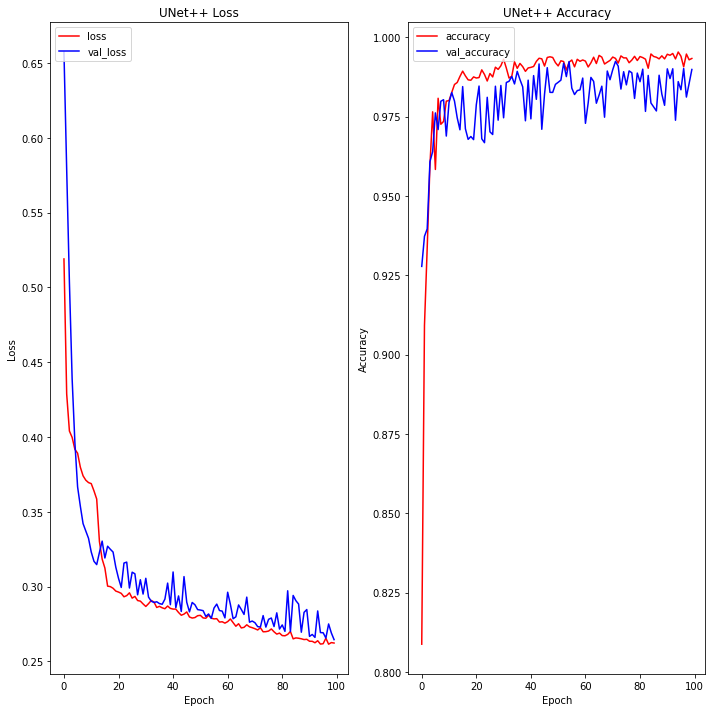

In [179]:
draw_history(unet_pp_history, 'UNet++')

In [192]:
history_dict = unet_pp_history.history

# Save the dictionary to a JSON file
with open("unet_pp_history.json", 'w') as json_file:
    json.dump(history_dict, json_file)

In [196]:
JSON_PATH = os.getenv('HOME') + '/aiffel/GoingDeeper/GD5/unet_pp_history.json'
with open(JSON_PATH, 'r') as f:
    history_unet_pp=json.load(f)

In [201]:
unet_history

{'loss': [0.6769990921020508,
  0.6630655527114868,
  0.6426630616188049,
  0.628406286239624,
  0.6096948385238647,
  0.5879724025726318,
  0.5685152411460876,
  0.5417147278785706,
  0.5213969945907593,
  0.4935555160045624,
  0.4717256426811218,
  0.4454539120197296,
  0.42077091336250305,
  0.3949100375175476,
  0.37283286452293396,
  0.3526541590690613,
  0.32926926016807556,
  0.30685028433799744,
  0.28506898880004883,
  0.26913225650787354,
  0.25473552942276,
  0.2371777445077896,
  0.22182025015354156,
  0.20980073511600494,
  0.20007452368736267,
  0.1883017122745514,
  0.17853976786136627,
  0.17049014568328857,
  0.16129498183727264,
  0.15574389696121216,
  0.14868906140327454,
  0.14290794730186462,
  0.14043918251991272,
  0.1344231516122818,
  0.12984421849250793,
  0.12294819205999374,
  0.12024860084056854,
  0.11654434353113174,
  0.11469995230436325,
  0.11253955215215683,
  0.1128719374537468,
  0.11052476614713669,
  0.10546331852674484,
  0.10405891388654709,
  

In [202]:
unet_pp_history

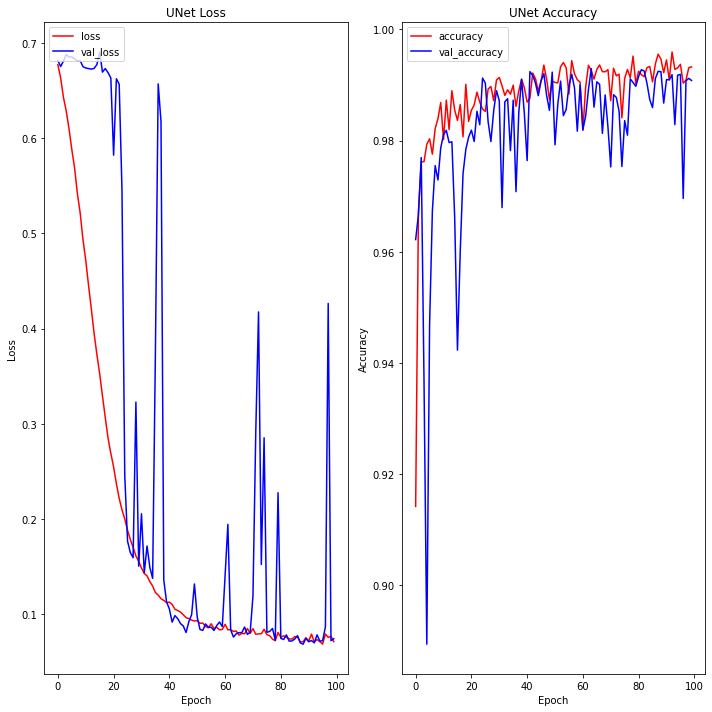

In [205]:
#json 파일로 부른 후에는 keras.callbacks.History 가 아닌 dict 그래서 history.history 에서 error
def draw_history_dict(history, model_name='UNet'):
    plt.subplots(figsize=(10, 10))

    # Model Loss, Validation Loss 시각화
    plt.subplot(121)
    plt.plot(history['loss'], 'r')
    plt.plot(history['val_loss'], 'b')
    plt.title(f'{model_name} Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['loss', 'val_loss'], loc='upper left')

    # Model Accuracy, Validation Accuracy 시각화
    plt.subplot(122)
    plt.plot(history['accuracy'], 'r')
    plt.plot(history['val_accuracy'], 'b')
    plt.title(f'{model_name} Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['accuracy', 'val_accuracy'], loc='upper left')

    plt.tight_layout()
    plt.show()

# Usage
draw_history_dict(unet_history, 'UNet')

In [207]:
history_unet_pp

{'loss': [0.5190014243125916,
  0.42876002192497253,
  0.4039779007434845,
  0.3997204601764679,
  0.3917751610279083,
  0.38916128873825073,
  0.379869669675827,
  0.37406161427497864,
  0.3711422085762024,
  0.36951953172683716,
  0.3688376545906067,
  0.36399033665657043,
  0.35853180289268494,
  0.3301485478878021,
  0.318385511636734,
  0.31240513920783997,
  0.3003171980381012,
  0.29999035596847534,
  0.2989000380039215,
  0.2970164120197296,
  0.2963515520095825,
  0.2954813838005066,
  0.29320213198661804,
  0.29397690296173096,
  0.29584380984306335,
  0.2922937870025635,
  0.29343950748443604,
  0.2906838357448578,
  0.29030153155326843,
  0.2884308397769928,
  0.28673383593559265,
  0.28860607743263245,
  0.29075807332992554,
  0.28966453671455383,
  0.2860611081123352,
  0.28681087493896484,
  0.285825252532959,
  0.2852347195148468,
  0.2870209515094757,
  0.2854229807853699,
  0.28498753905296326,
  0.2849458158016205,
  0.2827039062976837,
  0.28087061643600464,
  0.281

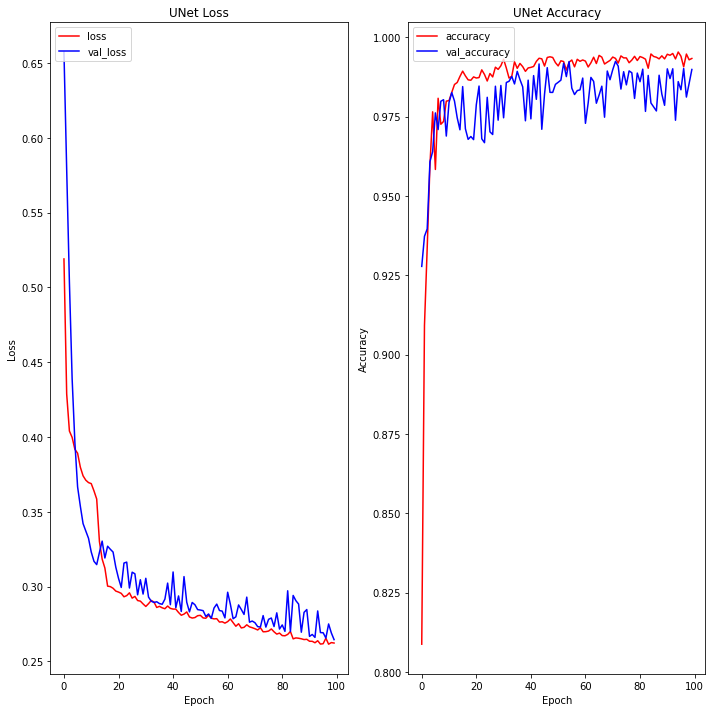

In [209]:
draw_history_dict(history_unet_pp, 'UNet')

# 결과분석

In [213]:
def calculate_iou_score(target, prediction):
    intersection = np.logical_and(target, prediction)
    union = np.logical_or(target, prediction)
    iou_score = float(np.sum(intersection)) / float(np.sum(union))
    return iou_score

In [221]:
def get_output_label(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()  
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return output, prediction, target
    else:
        return output, prediction, _

### UNET

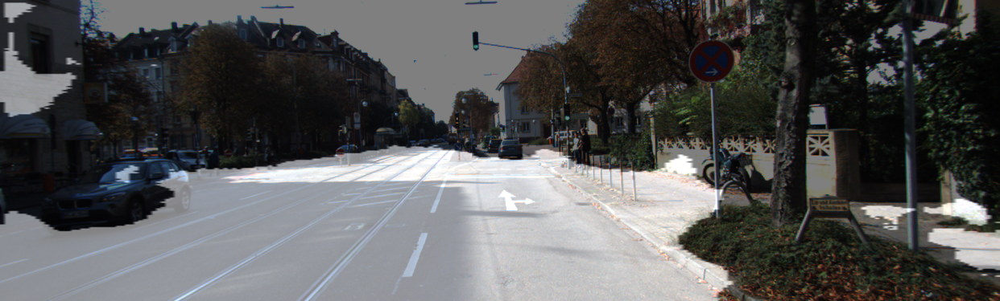

In [232]:
i = 1
output_unet, prediction_unet, target_unet = get_output_label(
     unet, 
     test_preproc,
     image_path=TRAIN_PATH + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=TRAIN_PATH + f'./result_{str(i).zfill(3)}.png',
     label_path=TRAIN_PATH + f'/semantic/00{str(i).zfill(4)}_10.png'
 )


In [233]:
calculate_iou_score(target_unet, prediction_unet)

0.7774689642393923

### UNET++

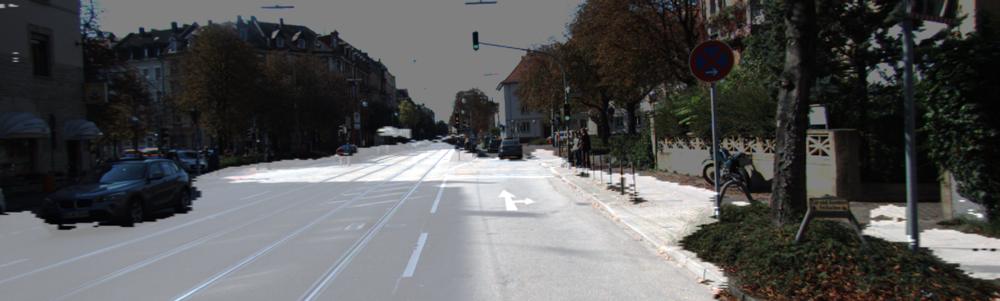

In [234]:
i = 1
output_unet_pp, prediction_unet_pp, target_unet_pp = get_output_label(
     unet_pp, 
     test_preproc,
     image_path=TRAIN_PATH + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=TRAIN_PATH + f'./result_{str(i).zfill(3)}.png',
     label_path=TRAIN_PATH + f'/semantic/00{str(i).zfill(4)}_10.png'
 )


In [235]:
calculate_iou_score(target_unet_pp, prediction_unet_pp)

0.8169352742396673

## 비교

UNET : 000000_10.png


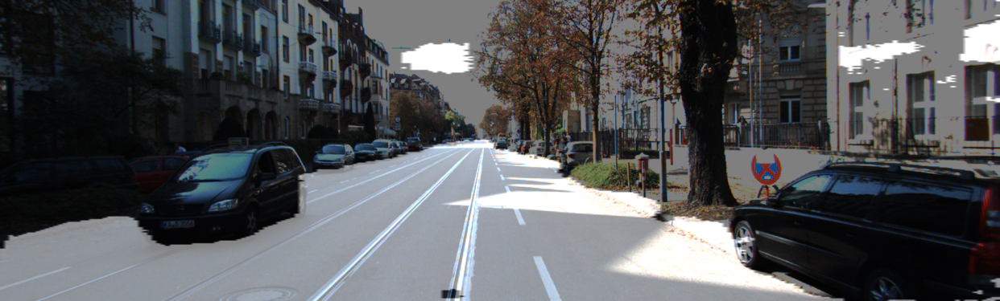

UNET++ : 000000_10.png


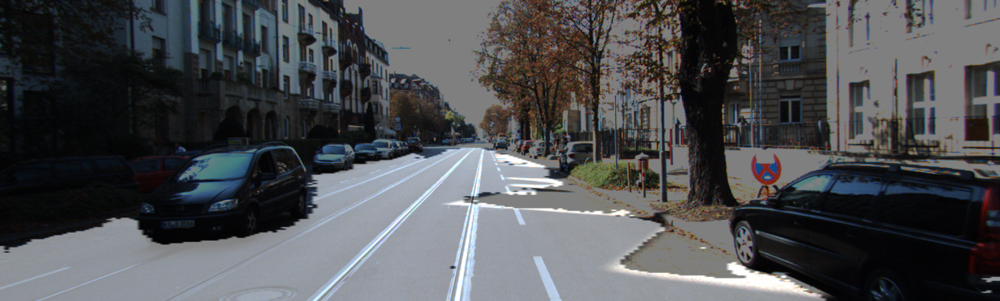




UNET : 000001_10.png


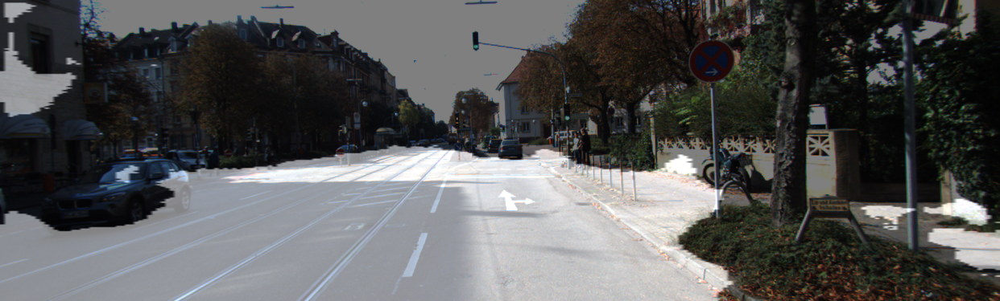

UNET++ : 000001_10.png


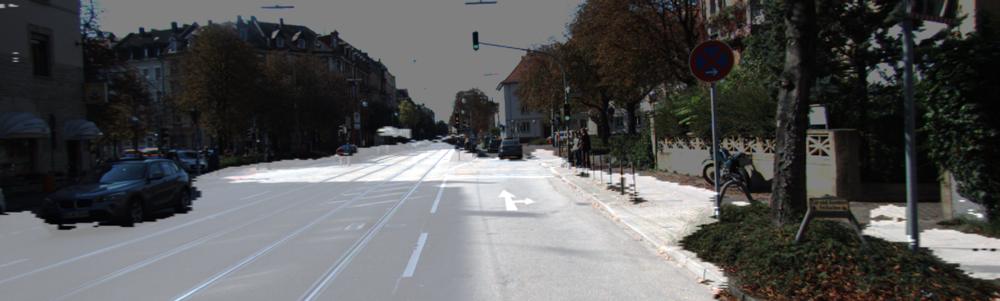




UNET : 000002_10.png


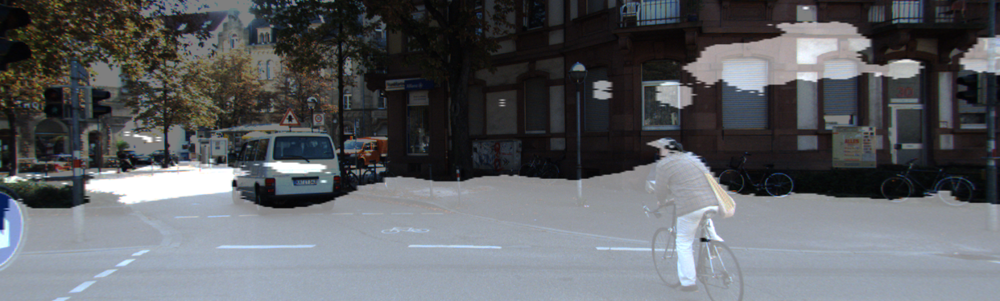

UNET++ : 000002_10.png


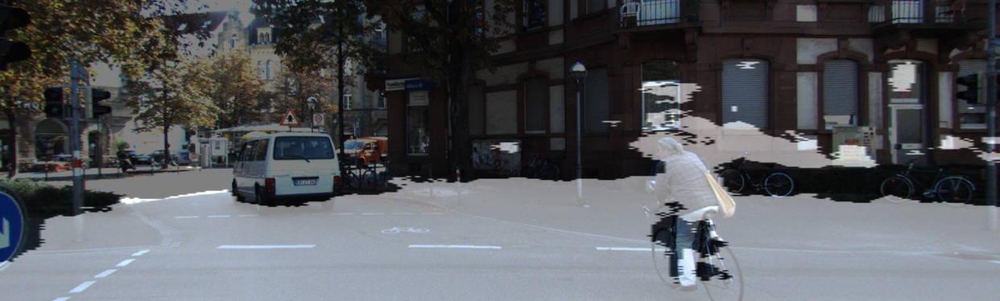




UNET : 000003_10.png


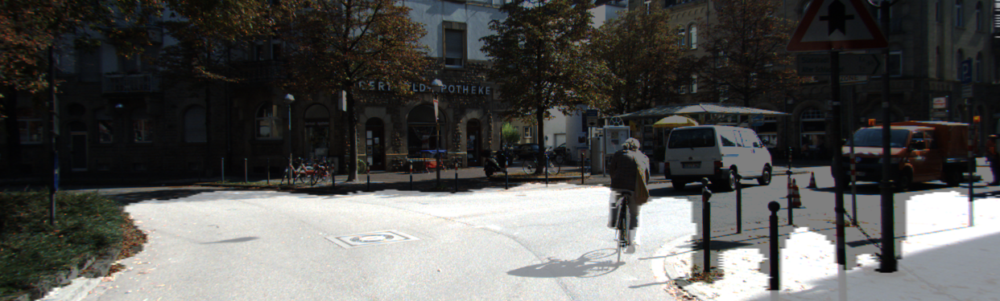

UNET++ : 000003_10.png


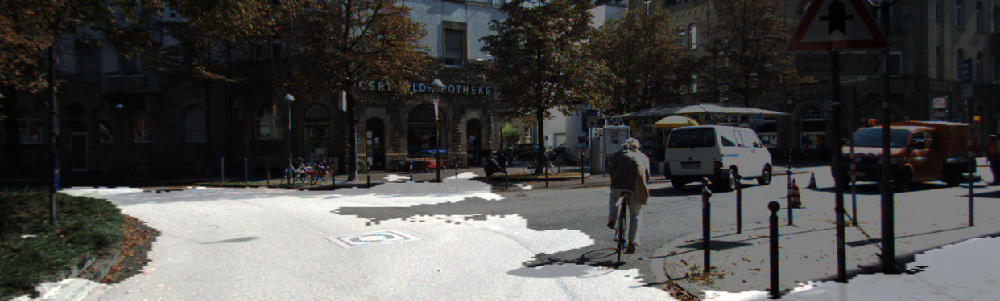




UNET : 000004_10.png


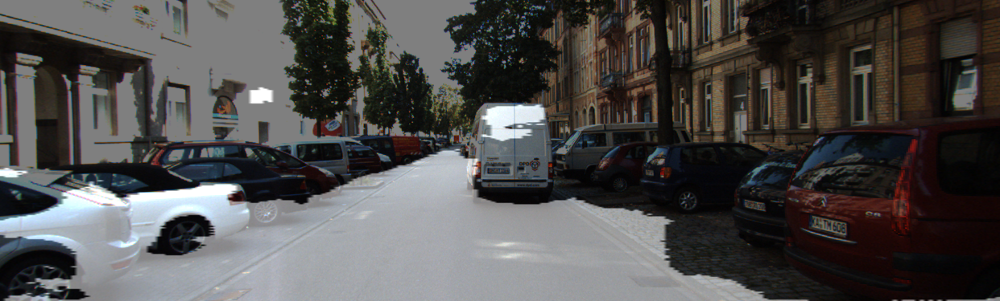

UNET++ : 000004_10.png


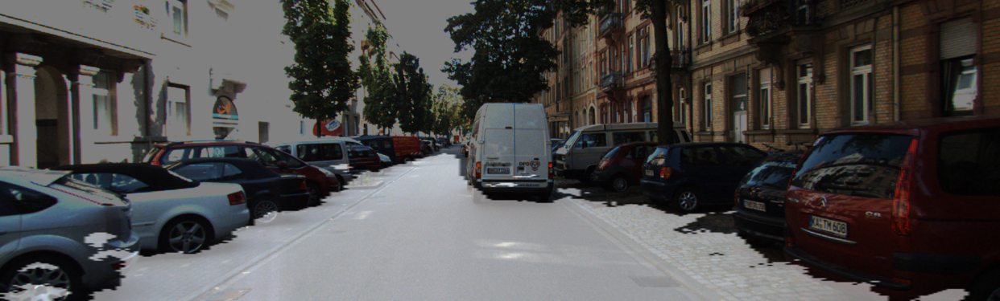




UNET : 000005_10.png


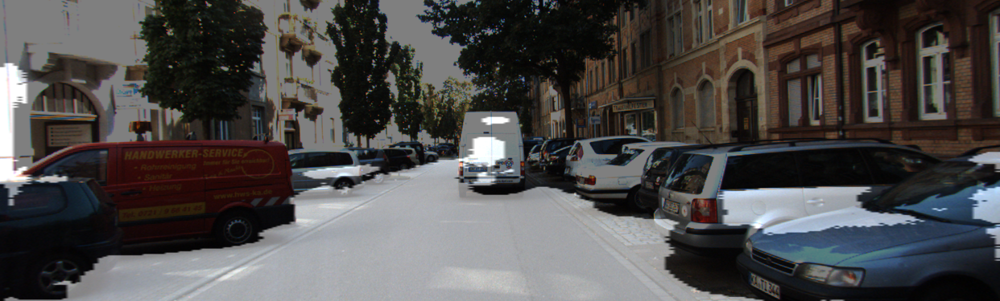

UNET++ : 000005_10.png


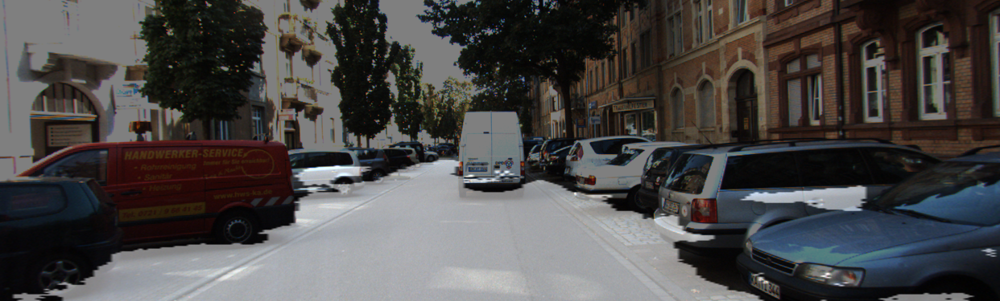




UNET : 000006_10.png


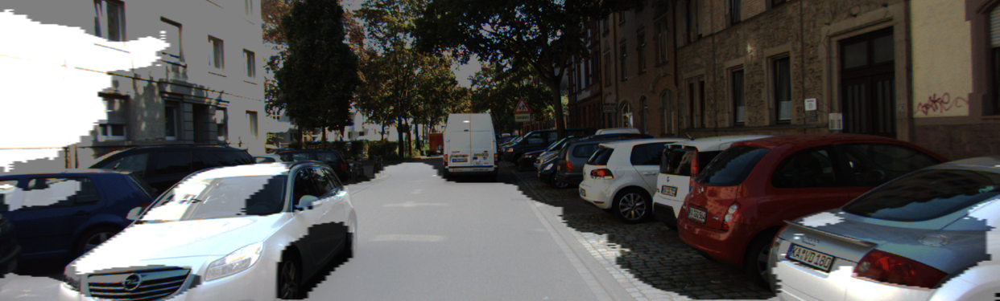

UNET++ : 000006_10.png


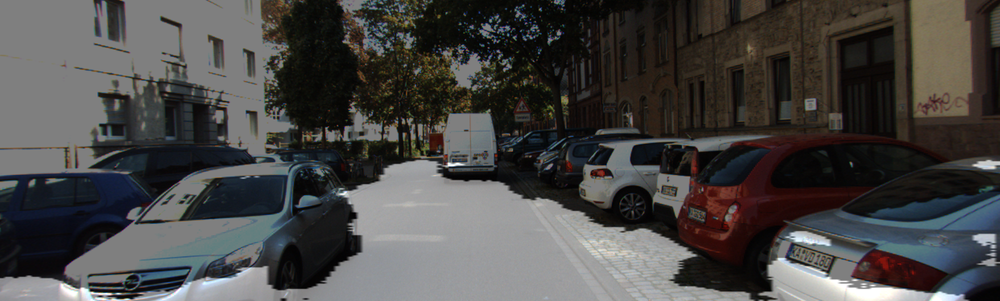




UNET : 000007_10.png


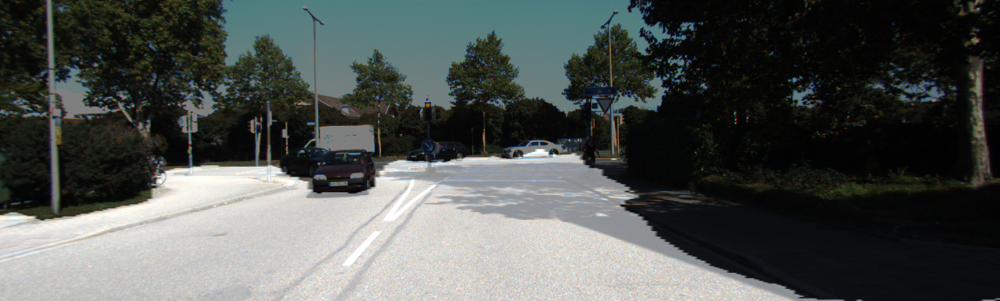

UNET++ : 000007_10.png


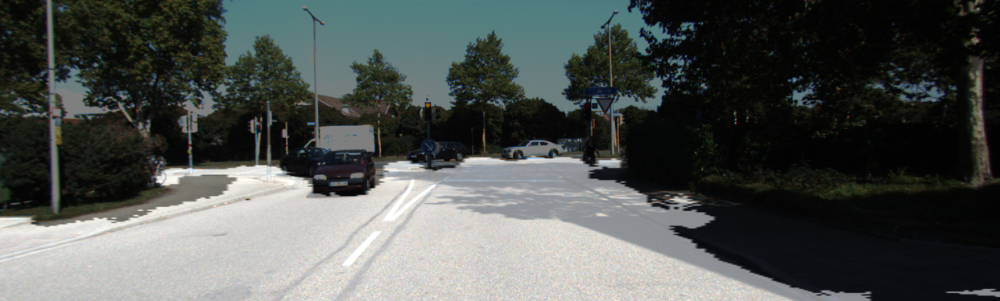




UNET : 000008_10.png


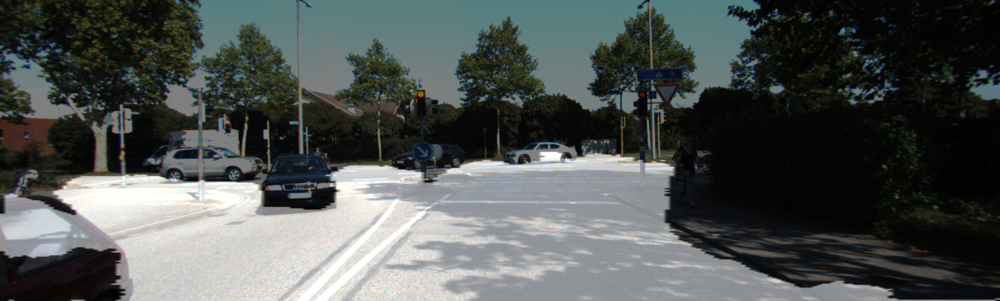

UNET++ : 000008_10.png


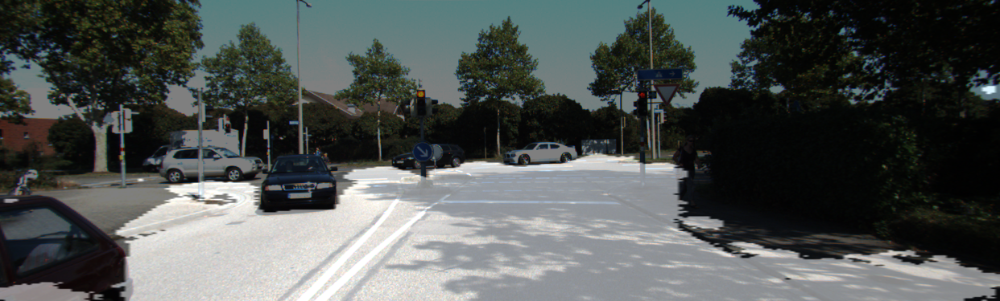




UNET : 000009_10.png


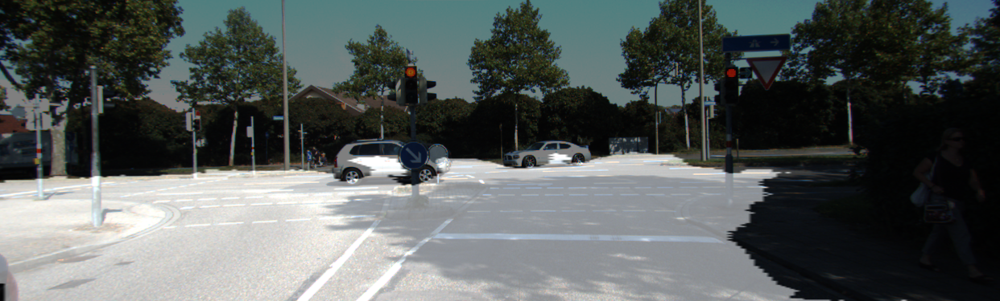

UNET++ : 000009_10.png


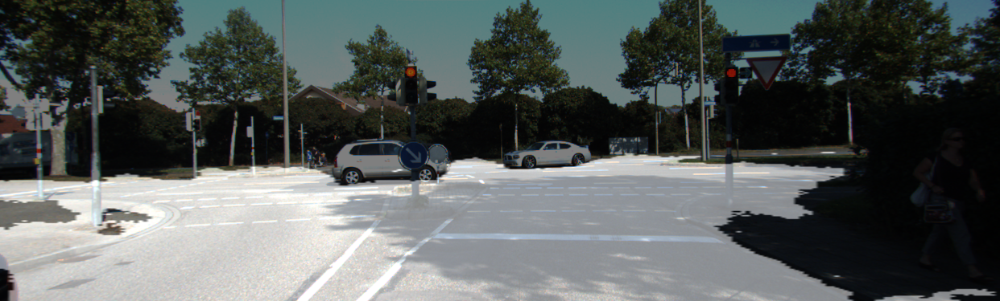

In [262]:
sum_unet = 0
iou_unet ={}
sum_unet_pp = 0
iou_unet_pp = {}
for i in range(10) :
    print(f'UNET : 00{str(i).zfill(4)}_10.png')
    output_unet, prediction_unet, target_unet = get_output_label(
     unet, 
     test_preproc,
     image_path=TRAIN_PATH + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=TRAIN_PATH + f'./result_{str(i).zfill(3)}.png',
     label_path=TRAIN_PATH + f'/semantic/00{str(i).zfill(4)}_10.png'
     )
    iou_unet[f'00{str(i).zfill(4)}_10.png'] = calculate_iou_score(target_unet, prediction_unet)
    sum_unet += calculate_iou_score(target_unet, prediction_unet)
    
    print(f'UNET++ : 00{str(i).zfill(4)}_10.png')
    output_unet_pp, prediction_unet_pp, target_unet_pp = get_output_label(
     unet_pp, 
     test_preproc,
     image_path=TRAIN_PATH + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=TRAIN_PATH + f'./result_{str(i).zfill(3)}.png',
     label_path=TRAIN_PATH + f'/semantic/00{str(i).zfill(4)}_10.png'
     )
    iou_unet_pp[f'00{str(i).zfill(4)}_10.png'] = calculate_iou_score(target_unet_pp, prediction_unet_pp)
    sum_unet_pp += calculate_iou_score(target_unet_pp, prediction_unet_pp)
    
    print("\n\n")

In [259]:
iou = pd.DataFrame({'IOU_UNET' : iou_unet.values(), 'IOU_UNET++' : iou_unet_pp.values()},index=iou_unet.keys() )

In [260]:
print(iou)

               IOU_UNET  IOU_UNET++
000000_10.png  0.886347    0.866948
000001_10.png  0.777469    0.816935
000002_10.png  0.532198    0.552466
000003_10.png  0.646830    0.589305
000004_10.png  0.539649    0.588067
000005_10.png  0.549004    0.603143
000006_10.png  0.349620    0.568162
000007_10.png  0.846930    0.871911
000008_10.png  0.775754    0.755612
000009_10.png  0.770881    0.815379


In [264]:
print(f' Average of IOU for UNET : {sum_unet / 10}')
print(f' Average of IOU for UNET++ : {sum_unet_pp / 10}')

 Average of IOU for UNET : 0.6674681802677026
 Average of IOU for UNET++ : 0.7027927707667263


# 회고

* 정성분석을 통하여 비교하였을 때, 확연히 차이나는 것을 알 수 없다.

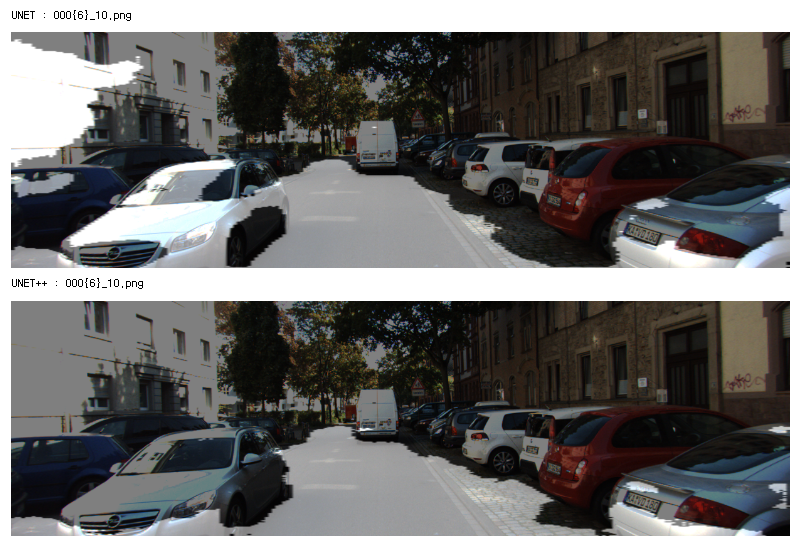

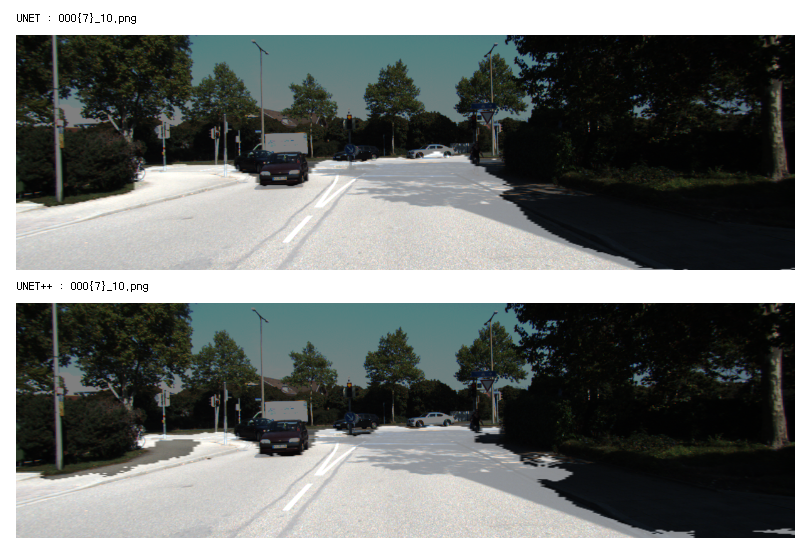

<br/>
<br/>

* 정량분석을 통해 비교 하였을 때, 평균 4%p 차이가 나는 것을 알 수 있다.

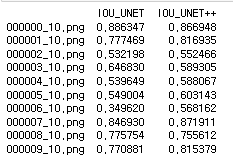
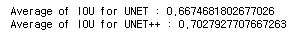

<br/>
<br/>
<br/>
<br/>
* 시간이 더 있었으면 추가 실험으로 Dropout(0.5)를 실험해보고 비교해보고싶었지만 아쉽다.

* json 파일로 부른 후에는 keras.callbacks.History 가 아닌 dict 그래서 history.history 에서 error
    * ----> 6  plt.plot(history.history['loss'], 'r')
    * AttributeError: 'dict' object has no attribute 'history'
        * history로 변경하여 문제 해결
    
* decoder 로 정의된 concatenate 부분에서 shape 에러 발생
    * ---> 15     x02 = decoder(filters[0], x11, [e00, x01])
    * ---> 3     x = concatenate([concat, x], axis=3)
    * ValueError: A `Concatenate` layer requires inputs with matching shapes except for the concat axis. Got inputs shapes: [(None, 224, 224, 64), (None, 112, 112, 64)]
    *  ValueError: A `Concatenate` layer should be called on a list of at least 1 input.
        * concat04 = concatenate([e00, x01, x02, x03], axis = -1)
        * x04 = decoder(filters[0], x13, concat04) 
        * 위 코드로 수정하여 문제 해결
            * 여기서 의문 x04 = decoder(filters[0], x13, [e00, x01, x02, x03]) 는 왜 error가 나타나는 것인가?
            * 이건 모르겠다.

* 00{str(i).zfill(4)}_10.png  -> 000000_10 , 000001_10 즉 str(i).zfill(4)는 4자리수 i로 표현
